In [ ]:
! kaggle datasets download -d kiva/data-science-for-good-kiva-crowdfunding

Dataset URL: https://www.kaggle.com/datasets/kiva/data-science-for-good-kiva-crowdfunding
License(s): CC0-1.0
 93% 39.0M/41.9M [00:00<00:00, 88.7MB/s]
100% 41.9M/41.9M [00:00<00:00, 79.9MB/s]


In [ ]:
#https://github.com/aaubs/ds-master/tree/main/data/assignments_datasets/KIVA

In [4]:
import pandas as pd
# Replace 'url' with your copied raw URL
url ='/content/drive/MyDrive/Assign-2/loan_themes_by_region.csv'
df_region = pd.read_csv('/content/drive/MyDrive/Assign-2/loan_themes_by_region.csv')
df_region.head()


,Partner ID,Field Partner Name,sector,Loan Theme ID,Loan Theme Type,country,forkiva,region,geocode_old,ISO,...,amount,LocationName,geocode,names,geo,lat,lon,mpi_region,mpi_geo,rural_pct
0,9,KREDIT Microfinance Institution,General Financial Inclusion,a1050000000slfi,Higher Education,Cambodia,No,Banteay Meanchey,"(13.75, 103.0)",KHM,...,450,"Banteay Meanchey, Cambodia","[(13.6672596, 102.8975098)]",Banteay Meanchey Province; Cambodia,"(13.6672596, 102.8975098)",13.667260,102.897510,"Banteay Mean Chey, Cambodia","(13.6672596, 102.8975098)",90.0
1,9,KREDIT Microfinance Institution,General Financial Inclusion,a10500000068jPe,Vulnerable Populations,Cambodia,No,Battambang Province,NaN,KHM,...,20275,"Battambang Province, Cambodia","[(13.0286971, 102.989615)]",Battambang Province; Cambodia,"(13.0286971, 102.989615)",13.028697,102.989615,"Banteay Mean Chey, Cambodia","(13.6672596, 102.8975098)",90.0
2,9,KREDIT Microfinance Institution,General Financial Inclusion,a1050000000slfi,Higher Education,Cambodia,No,Battambang Province,NaN,KHM,...,9150,"Battambang Province, Cambodia","[(13.0286971, 102.989615)]",Battambang Province; Cambodia,"(13.0286971, 102.989615)",13.028697,102.989615,"Banteay Mean Chey, Cambodia","(13.6672596, 102.8975098)",90.0
3,9,KREDIT Microfinance Institution,General Financial Inclusion,a10500000068jPe,Vulnerable Populations,Cambodia,No,Kampong Cham Province,"(12.0, 105.5)",KHM,...,604950,"Kampong Cham Province, Cambodia","[(12.0982918, 105.3131185)]",Kampong Cham Province; Cambodia,"(12.0982918, 105.3131185)",12.098292,105.313119,"Kampong Cham, Cambodia","(11.9924294, 105.4645408)",90.0
4,9,KREDIT Microfinance Institution,General Financial Inclusion,a1050000002X1Uu,Sanitation,Cambodia,No,Kampong Cham Province,"(12.0, 105.5)",KHM,...,275,"Kampong Cham Province, Cambodia","[(12.0982918, 105.3131185)]",Kampong Cham Province; Cambodia,"(12.0982918, 105.3131185)",12.098292,105.313119,"Kampong Cham, Cambodia","(11.9924294, 105.4645408)",90.0


In [ ]:
df_region.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15736 entries, 0 to 15735
Data columns (total 21 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Partner ID          15736 non-null  int64  
 1   Field Partner Name  15736 non-null  object 
 2   sector              15736 non-null  object 
 3   Loan Theme ID       15736 non-null  object 
 4   Loan Theme Type     15736 non-null  object 
 5   country             15736 non-null  object 
 6   forkiva             15736 non-null  object 
 7   region              15736 non-null  object 
 8   geocode_old         1200 non-null   object 
 9   ISO                 15722 non-null  object 
 10  number              15736 non-null  int64  
 11  amount              15736 non-null  int64  
 12  LocationName        15736 non-null  object 
 13  geocode             13662 non-null  object 
 14  names               13661 non-null  object 
 15  geo                 15736 non-null  object 
 16  lat 

In [ ]:
df_region.describe()

,number,amount,lat,lon,rural_pct
count,15736.000000,1.573600e+04,13662.000000,13662.000000,14344.000000
mean,53.628432,2.003991e+04,14.328878,29.433569,68.084635
std,403.079799,9.636941e+04,16.757689,83.255739,26.550064
min,1.000000,2.500000e+01,-34.610548,-172.790661,0.000000
25%,1.000000,9.500000e+02,6.266728,-71.967463,60.000000
50%,4.000000,2.600000e+03,13.484101,41.899993,73.000000
75%,15.000000,8.750000e+03,22.189940,106.677321,85.000000
max,22538.000000,4.929900e+06,51.314017,159.972900,100.000000


In [ ]:
df_region.drop(['Partner ID','Loan Theme ID','forkiva','geocode_old','ISO', 'geocode','names','geo','mpi_region','mpi_geo'], axis="columns", inplace=True)

In [ ]:
list(df_region.columns)

['Field Partner Name',
 'sector',
 'Loan Theme Type',
 'country',
 'region',
 'number',
 'amount',
 'LocationName',
 'lat',
 'lon',
 'rural_pct']

In [ ]:
df_region.isnull().sum()


,0
Field Partner Name,0
sector,0
Loan Theme Type,0
country,0
region,0
number,0
amount,0
LocationName,0
lat,2074
lon,2074


In [ ]:
mean_amount = df_region['amount'].mean()
print(mean_amount)

20039.906901372648


In [ ]:
median_amount = df_region['amount'].median()
print(median_amount)

2600.0


In [ ]:
mode_amount = df_region['amount'].mode()
print(mode_amount)

0    1000
Name: amount, dtype: int64


In [ ]:
#Given the mean, median and mode, it seems that we have more values in the lower amounts than that of higher amounts.

In [ ]:
import matplotlib.pyplot as plt # imports the matplotlib library and renames it to plt

In [ ]:
df_region['Loan Theme Type'].value_counts().head(10)

,count
Loan Theme Type,
General,5661
Agriculture,919
Underserved,696
Higher Education,649
Startup,485
Green,437
Water and Sanitation,390
Clean Cookstove,341
First/Second Chance,323


In [ ]:
list(df_region['Loan Theme Type'])
value_counts = df_region['Loan Theme Type'].value_counts()
filter_counts = value_counts[value_counts > 100]
print(filter_counts)

Loan Theme Type
General                   5661
Agriculture                919
Underserved                696
Higher Education           649
Startup                    485
Green                      437
Water and Sanitation       390
Clean Cookstove            341
First/Second Chance        323
Agriculture (Women)        310
Vulnerable Populations     303
Rural Inclusion            302
Youth                      281
Organic Agriculture        242
Education                  210
SME                        200
General (Women)            198
Women Entrepreneurs        185
Startup (Women)            169
End Consumer Finance       155
Extreme Poverty            153
Solar Home Systems         144
Health                     124
Single mothers             120
Unbanked                   116
School Finance             111
Vulnerable Women           109
Name: count, dtype: int64


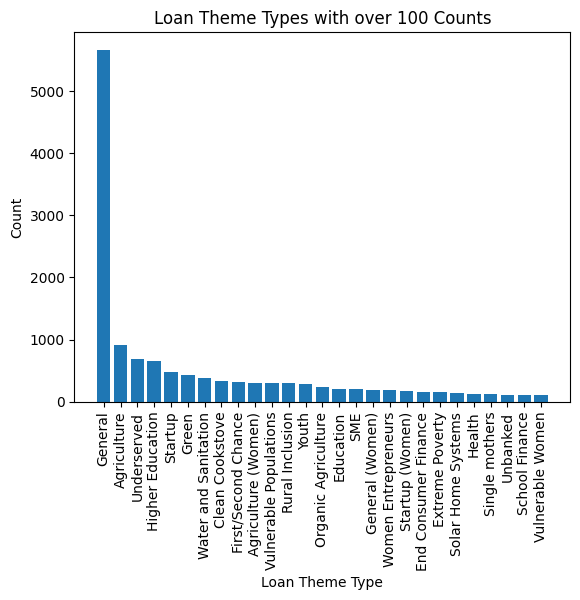

In [ ]:
#Following our now filtered selection earlier, we can use this selection and plot with ".index", which is the now filtered labels of the
#loan themes, and the ".values" which are the counted amount of rows for each of the loan themes.
plt.bar(filter_counts.index, filter_counts.values)
plt.xlabel('Loan Theme Type')
plt.ylabel('Count')
plt.title('Loan Theme Types with over 100 Counts')
plt.xticks(rotation=90)
plt.show()

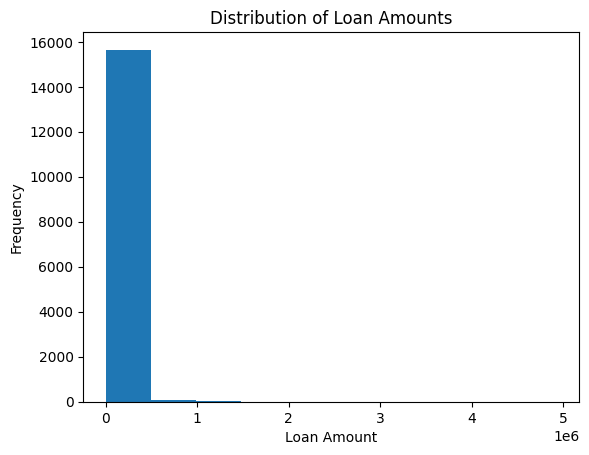

In [ ]:
plt.hist(df_region['amount'])
plt.xlabel('Loan Amount')
plt.ylabel('Frequency')
plt.title('Distribution of Loan Amounts')
plt.show()

In [ ]:
top_20_countries = df_region.groupby('country')['amount'].sum().nlargest(10).index

In [ ]:
df_region.groupby('Loan Theme Type')['amount'].mean()

,amount
Loan Theme Type,
Agricultural Equipment,7557.500000
Agricultural Infrastructure,4954.166667
Agricultural Labor,2594.444444
Agriculture,11984.847661
Agriculture (Women),3518.225806
...,...
Youth,15212.900356
Youth (Women),41982.142857
Youth Entrepreneurship,12141.666667


In [ ]:
import folium

# Ensure correct data types for longitude and latitude
df_region['lon'] = df_region['lon'].astype(float)
df_region['lat'] = df_region['lat'].astype(float)

# filter out Nans in lat/lon
df_region = df_region.dropna(subset=['lat', 'lon'])

# Create a map centered around the global center
world_map = folium.Map(location=[0, 0], zoom_start=2)

# Add city markers to the map
for idx, row in df_region.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lon']],
        radius=5,
        # Define what variables to display in the pop-ups
        popup=f"{row['Field Partner Name']}, {row['sector']} {row['country']}",
        color="blue",
        fill=True,
        fill_color="blue"
    ).add_to(world_map)

world_map


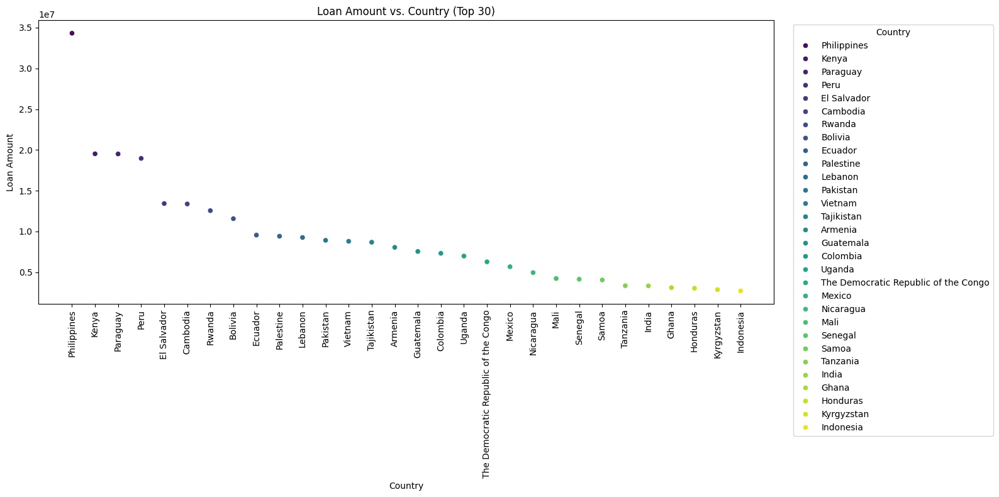

In [12]:
# Calculate the total loan amount for each country
country_loan_amounts = df_region.groupby('country')['amount'].sum()

# Get the top 30 countries by loan amount
top_30_countries = country_loan_amounts.sort_values(ascending=False).head(30)

# Convert the Series to DataFrame and reset the index
top_30_countries = top_30_countries.to_frame().reset_index()
#Import the matplotlib.pplot module
import matplotlib.pyplot as plt
#Import the seaborn module
import seaborn as sns

plt.figure(figsize=(16, 8))
sns.scatterplot(x='country', y='amount', data=top_30_countries, hue='country', palette='viridis')
plt.title('Loan Amount vs. Country (Top 30)')
plt.xlabel('Country')
plt.ylabel('Loan Amount')
plt.xticks(rotation=90)
plt.legend(title='Country', bbox_to_anchor=(1.02, 1), loc='upper left')
plt.tight_layout()
plt.show()